<div style="background-color: white; padding: 20px; border-radius: 8px; box-shadow: 0px 4px 8px rgba(0, 0, 0, 0.1); color: #333; font-family: Arial, sans-serif;">
    <h3 style="font-size: 22px; font-weight: bold; color: #20639B; margin-bottom: 10px;">1. Import Libraries </h3>
    
</div>

In [18]:
import numpy as np
import pandas as pd
import tensorflow as tf
import matplotlib.pyplot as plt
import os
import wave
import pylab
import itertools
import librosa
import librosa.display
from tensorflow.keras import layers, models, callbacks
from tensorflow.keras.models import load_model
from keras.utils import plot_model
from pathlib import Path
from sklearn.model_selection import train_test_split
from scipy import signal
from scipy.io import wavfile


import warnings
warnings.filterwarnings ('ignore')

In [2]:
INPUT_DIR = 'dataset'

files_in_dir = os.listdir(INPUT_DIR)

print(files_in_dir)

['01. alif_fathah', '02. alif_kasroh', '03. alif_dommah', '04. ba_fathah', '05. ba_kasroh', '06. ba_dommah', '07. ta_fathah', '08. ta_kasroh', '09. ta_dommah', '10. tsa_fathah', '11. tsa_kasroh', '12. tsa_dommah', '13. jim_fathah', '14. jim_kasroh', '15. jim_dommah', '16. hah_fathah', '17. hah_kasroh', '18. hah_dommah', '19. kha_fathah', '20. kha_kasroh', '21. kha_dommah', '22. dal_fathah', '23. dal_kasroh', '24. dal_dommah', '25. dzal_fathah', '26. dzal_kasroh', '27. dzal_dommah', '28. ra_fathah', '29. ra_kasroh', '30. ra_dommah', '31. zay_fathah', '32. zay_kasroh', '33. zay_dommah', '34. sin_fathah', '35. sin_kasroh', '36. sin_dommah', '37. shin_fathah', '38. shin_kasroh', '39. shin_dommah', '40. sad_fathah', '41. sad_kasroh', '42. sad_dommah', '43. dad_fathah', '44. dad_kasroh', '45. dad_dommah', '46. tah_fathah', '47. tah_kasroh', '48. tah_dommah', '49. zah_fathah', '50. zah_kasroh', '51. zah_dommah', '52. ain_fathah', '53. ain_kasroh', '54. ain_dommah', '55. ghaiin_fathah', '56. g

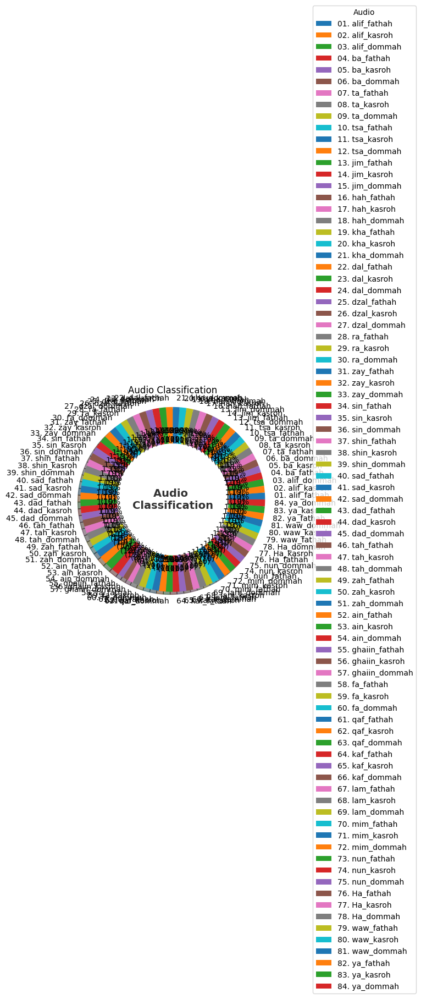

In [4]:
subdirectories = [subdir for subdir in os.listdir(INPUT_DIR) if os.path.isdir(os.path.join(INPUT_DIR, subdir))]
num_wav_files = []
for subdir in subdirectories:
    subdir_path = os.path.join(INPUT_DIR, subdir)
    wav_files = [file for file in os.listdir(subdir_path) if file.endswith('.wav')]
    num_wav_files.append(len(wav_files))

total_files = sum(num_wav_files)
percentages = [(num_files / total_files) * 100 for num_files in num_wav_files]

unique_emotion = subdirectories

explode = [0] * len(unique_emotion)

fig, ax = plt.subplots()

wedges, texts, autotexts = ax.pie(
    x=num_wav_files, 
    labels=unique_emotion,
    autopct=lambda p: f'{p:.2f}%\n({int(p*total_files/100)})', 
    wedgeprops=dict(width=0.7),
    textprops=dict(size=10, color="black"),  
    pctdistance=0.7,
    explode=explode,  
    shadow=True
)

center_circle = plt.Circle((0, 0), 0.6, color='white', fc='white', linewidth=1.25)
fig.gca().add_artist(center_circle)

ax.text(0, 0, 'Audio \nClassification', ha='center', va='center', fontsize=14, fontweight='bold', color='#333333')

ax.legend(unique_emotion, title="Audio", loc="center left", bbox_to_anchor=(1, 0, 0.5, 1))

ax.axis('equal')  
plt.title('Audio Classification')

plt.show()

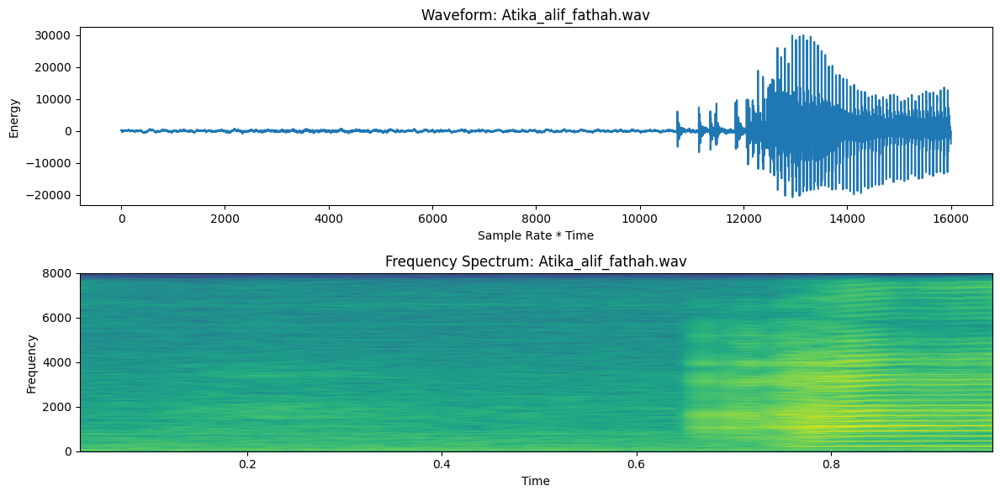

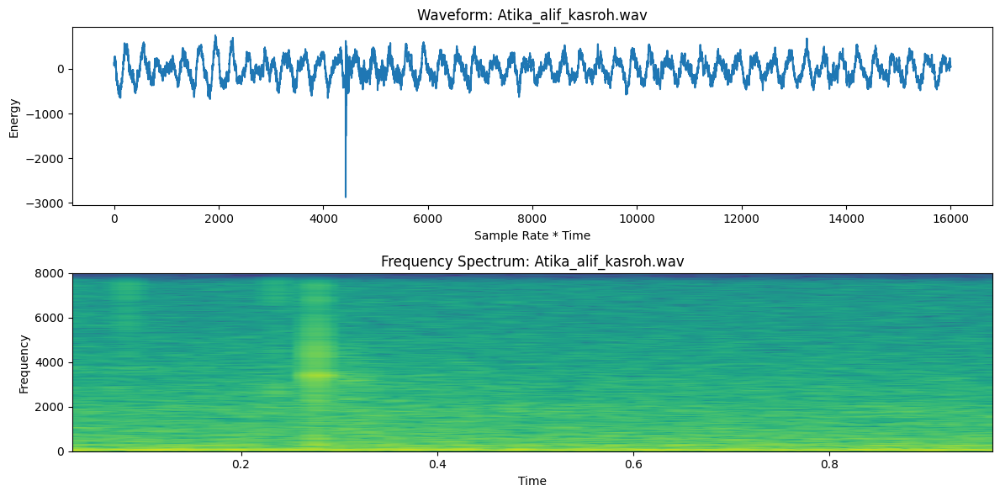

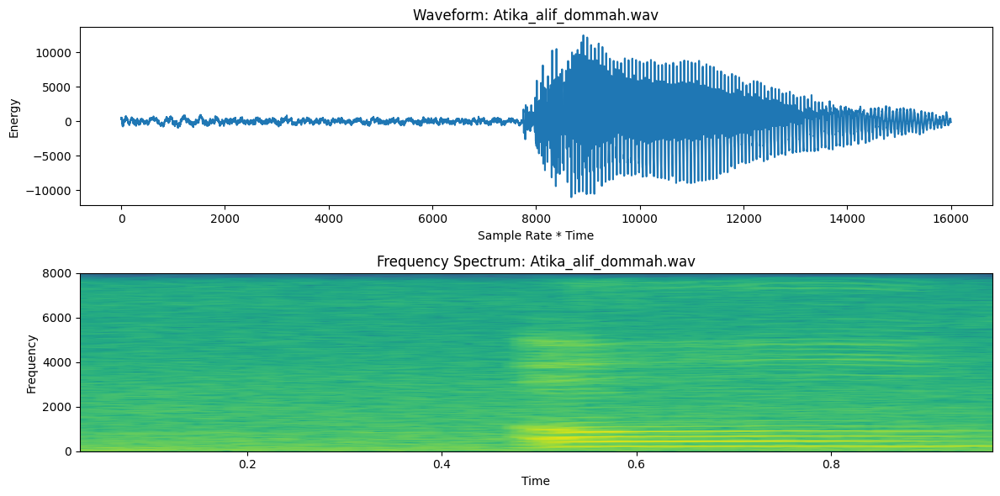

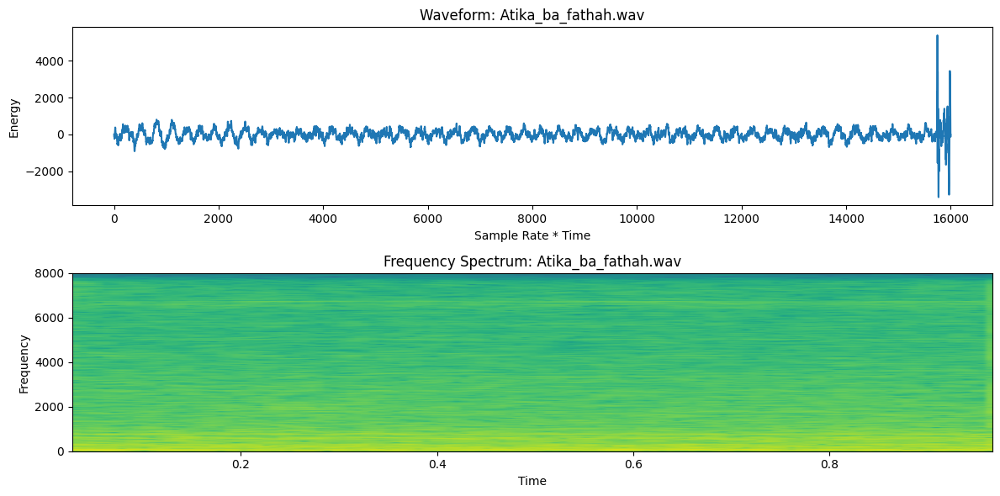

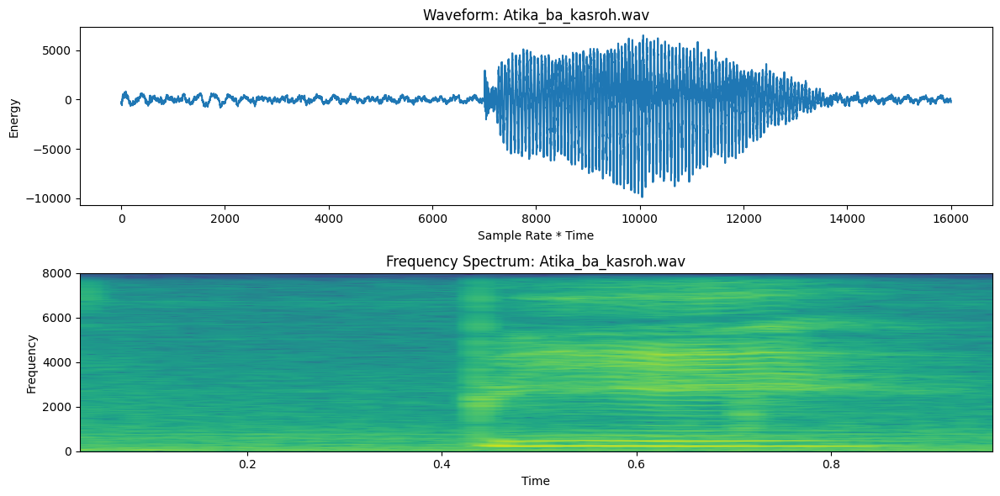

...

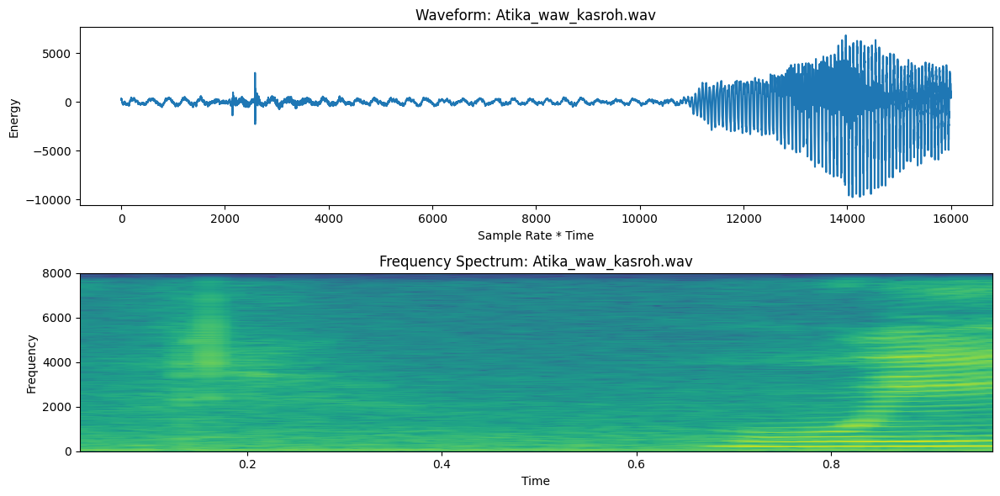

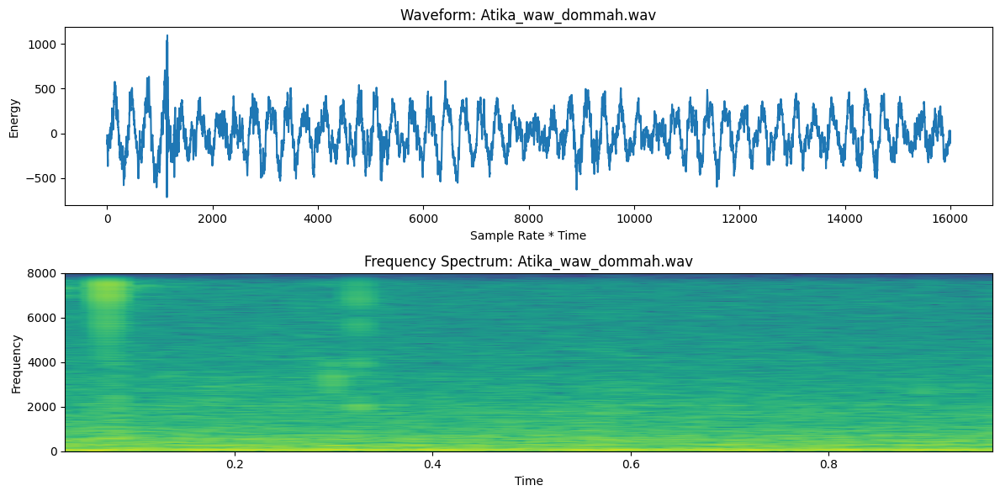

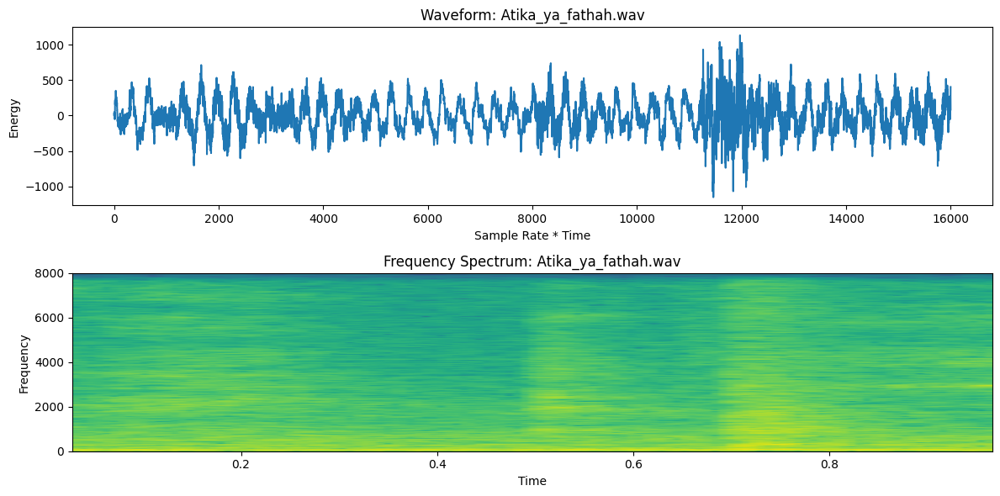

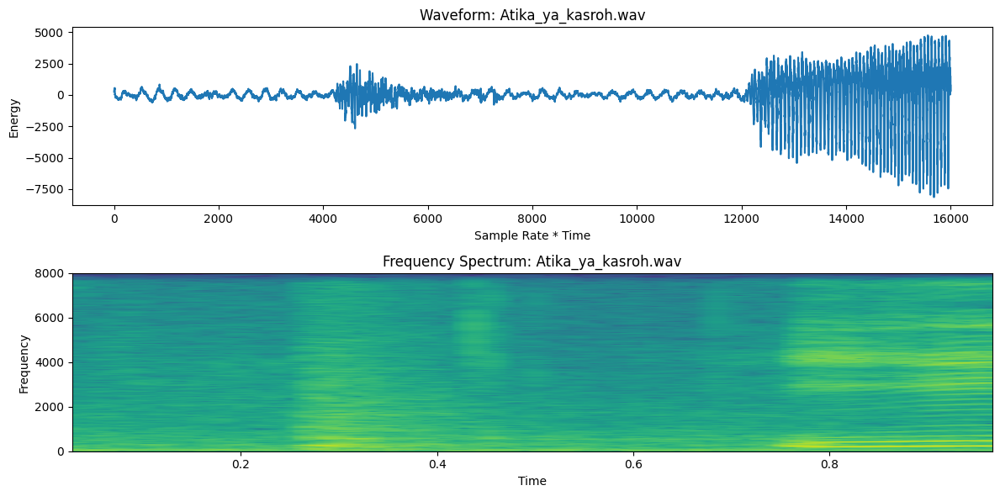

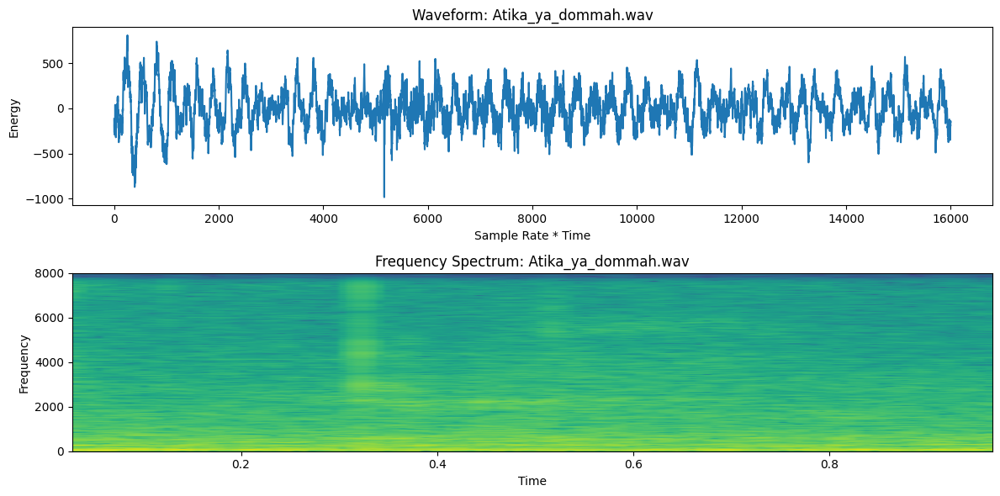

In [5]:
subdirectories = [subdir for subdir in os.listdir(INPUT_DIR) if os.path.isdir(os.path.join(INPUT_DIR, subdir))]

for subdir in subdirectories:
    subdir_path = os.path.join(INPUT_DIR, subdir)
    wav_files = [file for file in os.listdir(subdir_path) if file.endswith('.wav')]

    for i in range(min(1, len(wav_files))):
        file_path = os.path.join(subdir_path, wav_files[i])
        signal_wave = wave.open(file_path, 'r')
        sample_rate = 16000
        sig = np.frombuffer(signal_wave.readframes(sample_rate), dtype=np.int16)

        plt.figure(figsize=(12, 6))
        plt.subplot(211)
        plt.title(f'Waveform: {wav_files[i]}')
        plt.plot(sig)
        plt.xlabel('Sample Rate * Time')
        plt.ylabel('Energy')

        plt.subplot(212)
        plt.specgram(sig, NFFT=1024, Fs=sample_rate, noverlap=900)
        plt.title(f'Frequency Spectrum: {wav_files[i]}')
        plt.xlabel('Time')
        plt.ylabel('Frequency')

        plt.tight_layout()
        plt.show()

<div style="background-color: white; padding: 20px; border-radius: 8px; box-shadow: 0px 4px 8px rgba(0, 0, 0, 0.1); color: #333; font-family: Arial, sans-serif;">
    <h3 style="font-size: 22px; font-weight: bold; color: #20639B; margin-bottom: 10px;">3.Feature Extraction </h3>
    
</div>

In [6]:
def load_and_extract_spectrogram(file_path, n_mels=128, n_fft=2048, hop_length=512):
    y, sr = librosa.load(file_path, sr=None)  
    mel_spec = librosa.feature.melspectrogram(y=y, sr=sr, n_fft=n_fft, hop_length=hop_length, n_mels=n_mels)
    mel_spec_db = librosa.power_to_db(mel_spec, ref=np.max)  
    return mel_spec_db

In [7]:
subdirectories = [subdir for subdir in os.listdir(INPUT_DIR) if os.path.isdir(os.path.join(INPUT_DIR, subdir))]

In [8]:
X = []
y = []
max_time_steps = 128  
for idx, subdir in enumerate(subdirectories):
    subdir_path = os.path.join(INPUT_DIR, subdir)
    wav_files = [file for file in os.listdir(subdir_path) if file.endswith('.wav')]

    for wav_file in wav_files:
        file_path = os.path.join(subdir_path, wav_file)
        spectrogram = load_and_extract_spectrogram(file_path)
        if spectrogram.shape[1] < max_time_steps:
            pad_width = max_time_steps - spectrogram.shape[1]
            spectrogram_padded = np.pad(spectrogram, ((0, 0), (0, pad_width)), mode='constant')
            X.append(spectrogram_padded)
        else:
            X.append(spectrogram[:, :max_time_steps])  # Trim if spectrogram has more time steps
        y.append(idx)  # Use class index as label

In [9]:
X = np.array(X)
y = np.array(y)


X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

X_train = X_train[..., np.newaxis]
X_test = X_test[..., np.newaxis]

<div style="background-color: white; padding: 20px; border-radius: 8px; box-shadow: 0px 4px 8px rgba(0, 0, 0, 0.1); color: #333; font-family: Arial, sans-serif;">
    <h3 style="font-size: 22px; font-weight: bold; color: #20639B; margin-bottom: 10px;">4.CNN Modeling </h3>
    
</div>

In [10]:
model = models.Sequential([
    layers.Conv2D(32, (3, 3), activation='relu', input_shape=(X_train.shape[1:])),
    layers.MaxPooling2D((2, 2)),
    layers.Conv2D(64, (3, 3), activation='relu'),
    layers.MaxPooling2D((2, 2)),
    layers.Conv2D(128, (3, 3), activation='relu'),
    layers.MaxPooling2D((2, 2)),
    layers.Conv2D(256, (3, 3), activation='relu'),
    layers.MaxPooling2D((2, 2)),
    layers.Flatten(),
    layers.Dense(512, activation='relu'),
    layers.Dropout(0.5), 
    layers.Dense(256, activation='relu'),
    layers.Dense(len(subdirectories), activation='softmax')
])


model.compile(optimizer='adam',
            loss='sparse_categorical_crossentropy',
            metrics=['accuracy'])

In [11]:
model.summary()

Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d (Conv2D)                 │ (None, 126, 126, 32)   │           320 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d (MaxPooling2D)    │ (None, 63, 63, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_1 (Conv2D)               │ (None, 61, 61, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_1 (MaxPooling2D)  │ (None, 30, 30, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_2 (Conv2D)               │ (None, 28, 28, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_2 (MaxPooling2D)  │ (None, 14, 14, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_3 (Conv2D)               │ (None, 12, 12, 256)    │       295,168 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_3 (MaxPooling2D)  │ (None, 6, 6, 256)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten (Flatten)               │ (None, 9216)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 512)            │     4,719,104 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 512)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 256)            │       131,328 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_2 (Dense)                 │ (None, 84)             │        21,588 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 5,259,860 (20.06 MB)

 Trainable params: 5,259,860 (20.06 MB)

 Non-trainable params: 0 (0.00 B)

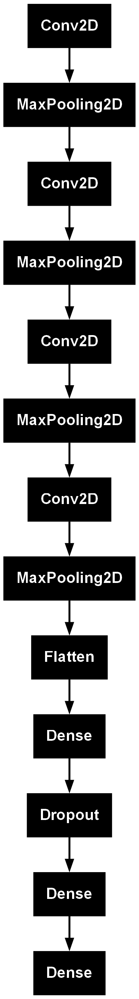

In [12]:
plot_model(model, to_file='model.png')

<div style="background-color: white; padding: 20px; border-radius: 8px; box-shadow: 0px 4px 8px rgba(0, 0, 0, 0.1); color: #333; font-family: Arial, sans-serif;">
    <h3 style="font-size: 22px; font-weight: bold; color: #20639B; margin-bottom: 10px;">4.Training and Validation </h3>
    
</div>


In [13]:
early_stopping = callbacks.EarlyStopping(monitor='val_loss', patience=3, restore_best_weights=True)

history = model.fit(X_train, y_train, epochs=30, validation_data=(X_test, y_test))

#, callbacks=[early_stopping]

Epoch 1/30
21/21 ━━━━━━━━━━━━━━━━━━━━ 4s 126ms/step - accuracy: 0.0082 - loss: 6.2332 - val_accuracy: 0.0119 - val_loss: 4.4379
Epoch 2/30
21/21 ━━━━━━━━━━━━━━━━━━━━ 3s 119ms/step - accuracy: 0.0162 - loss: 4.4343 - val_accuracy: 0.0000e+00 - val_loss: 4.4496
Epoch 3/30
21/21 ━━━━━━━━━━━━━━━━━━━━ 2s 117ms/step - accuracy: 0.0218 - loss: 4.4191 - val_accuracy: 0.0000e+00 - val_loss: 4.4535
Epoch 4/30
21/21 ━━━━━━━━━━━━━━━━━━━━ 3s 124ms/step - accuracy: 0.0306 - loss: 4.4043 - val_accuracy: 0.0000e+00 - val_loss: 4.5836
Epoch 5/30
21/21 ━━━━━━━━━━━━━━━━━━━━ 3s 122ms/step - accuracy: 0.0274 - loss: 4.3339 - val_accuracy: 0.0000e+00 - val_loss: 4.5138
Epoch 6/30
21/21 ━━━━━━━━━━━━━━━━━━━━ 3s 123ms/step - accuracy: 0.0365 - loss: 4.3023 - val_accuracy: 0.0000e+00 - val_loss: 4.5201
Epoch 7/30
21/21 ━━━━━━━━━━━━━━━━━━━━ 3s 120ms/step - accuracy: 0.0340 - loss: 4.2677 - val_accuracy: 0.0000e+00 - val_loss: 4.5858
Epoch 8/30
21/21 ━━━━━━━━━━━━━━━━━━━━ 2s 115ms/step - accuracy: 0.0357 - loss: 4

In [14]:
evaluation_result = model.evaluate(X_test, y_test)

print("Test Loss:", evaluation_result[0])
print("Test Accuracy:", evaluation_result[1])

6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step - accuracy: 0.0091 - loss: 5.8607   
Test Loss: 5.803913116455078
Test Accuracy: 0.01785714365541935


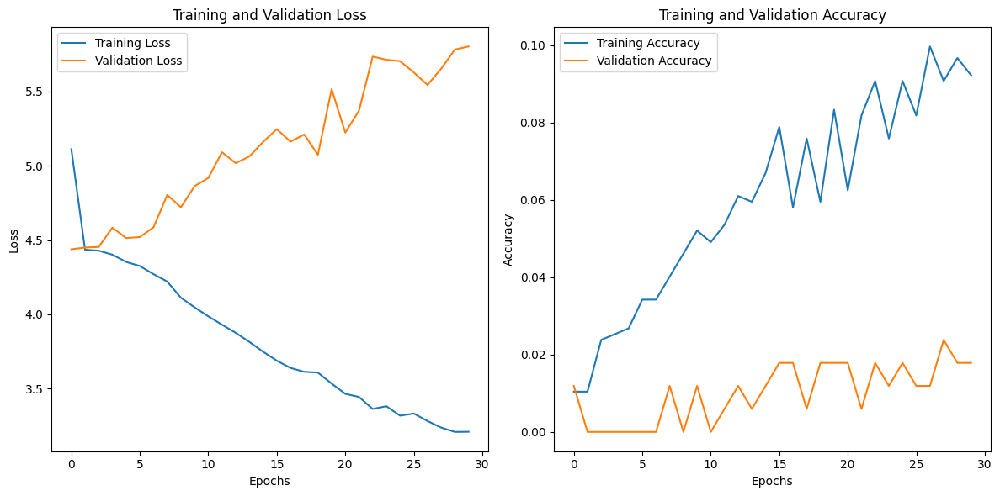

In [15]:
plt.figure(figsize=(12, 6))

plt.subplot(1, 2, 1)
plt.plot(history.history['loss'], label='Training Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.title('Training and Validation Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()

plt.subplot(1, 2, 2)
plt.plot(history.history['accuracy'], label='Training Accuracy')
plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
plt.title('Training and Validation Accuracy')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend()

plt.tight_layout()
plt.show()

In [17]:
model.save('model.keras')

In [ ]:
# Load model yang telah dilatih
loaded_model = load_model('model.keras')